In [2]:
from pathlib import Path
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

np.set_printoptions(precision=3, suppress=True)
torch.set_printoptions(precision=3, sci_mode=False)

import sys
sys.path.append('/home/gkinoshita/workspace/monodepth2')

from layers import disp_to_depth
from utils import depths2cam_pts, cam_pts2cam_height_with_cross_prod, generate_cam_grid

In [3]:
w, h = 1024, 320
cam_idx = "02"
resolution = f"{w}x{h}"
K = torch.tensor([[0.58, 0, 0.5], [0, 1.92, 0.5], [0, 0, 1]], dtype=torch.float32)
K[0, :] *= w
K[1, :] *= h
fy = K[1, 1]
invK = torch.linalg.pinv(K)

is_manydepth = False

root_dir = Path("/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync")
if is_manydepth:
    disp_dir = root_dir / f"disp_manydepth_multi_{resolution}_{cam_idx}"
else:
    disp_dir = root_dir / f"disp_{resolution}_{cam_idx}"
segm_dir = root_dir / f"modified_segms_labels_person_car_road_{resolution}_{cam_idx}"
img_dir = root_dir / f"image_{resolution}_{cam_idx}"

In [4]:
# def project_on_road(road_normal: torch.Tensor, cam_height: float, _point_cloud: torch.Tensor) -> torch.Tensor:
#     """
#         road_normal (torch.Tensor): [3]
#         cam_height (float)
#         _point_cloud (torch.Tensor): [n_pts, 3]

#     Returns:
#         torch.Tensor: _description_
#     """
#     _, ny, nz = road_normal
#     origin = torch.tensor((0, -cam_height / ny, 0), dtype=torch.float32)
#     root = torch.sqrt(ny**2 / (nz**2 + ny**2))
#     basis2 = torch.tensor((0, -nz/ny * root, root), dtype=torch.float32)
#     basis1 = torch.cross(basis2, road_normal)
#     print(road_normal)
#     print(basis1)
#     print(basis2)
#     point_cloud = _point_cloud - origin
#     xs = point_cloud @ basis1
#     ys = point_cloud @ basis2
#     return xs, ys

def convert_coords_projected_normal_vecs(road_normal: torch.Tensor, projected_normal_vecs: torch.Tensor) -> torch.Tensor:
    """
        road_normal (torch.Tensor): [3]
        _point_cloud (torch.Tensor): [n_pts, 3]

    Returns:
        torch.Tensor: _description_
    """
    _, ny, nz = road_normal
    root = torch.sqrt(ny**2 / (nz**2 + ny**2))
    basis2 = torch.tensor((0, -nz/ny * root, root), dtype=torch.float32)
    basis1 = torch.cross(basis2, road_normal)
    xs = projected_normal_vecs @ basis1
    ys = projected_normal_vecs @ basis2
    return xs, ys

- あくまでも最初にプロットしていたのは法線ベクトル（なので位置はどうでもいい）
    - 法線を道路平面にプロジェクトする場合はオリジンに移動させる必要はない
- なのでproject_on_roadで今プロットしているのは法線ベクトルを道路平面上にプロジェクトした要素であるため，それは半径1の円内にあるのは当たり前

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000501.npz


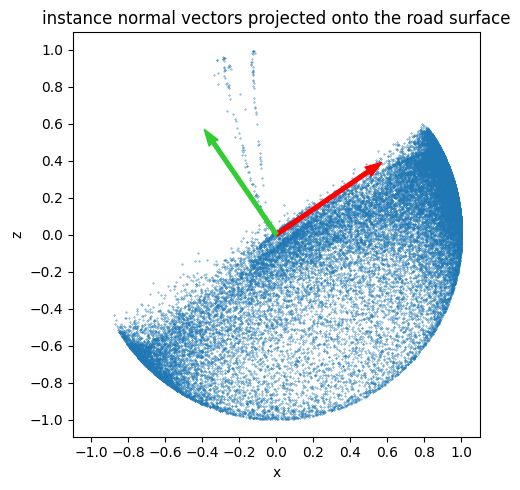

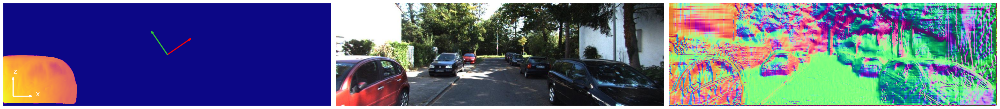

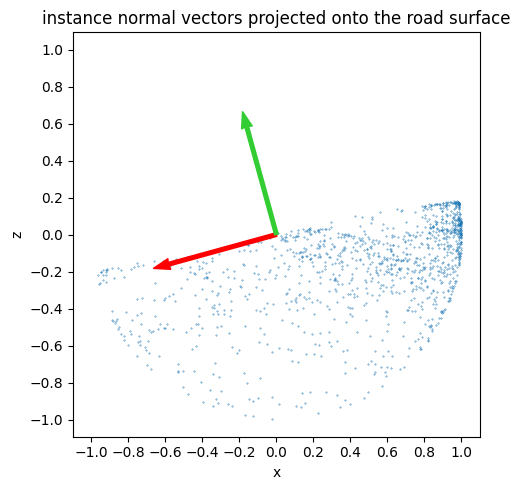

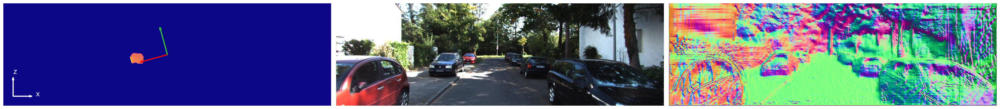

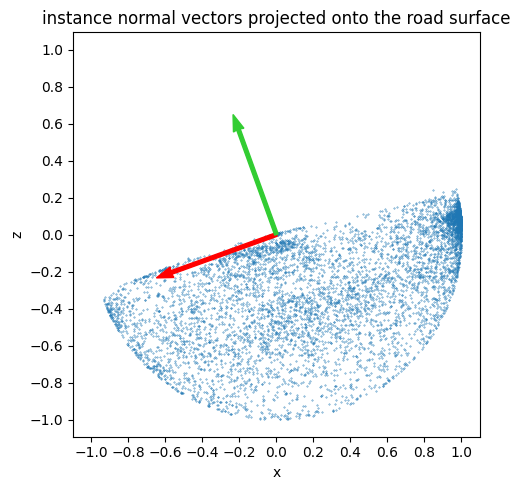

...

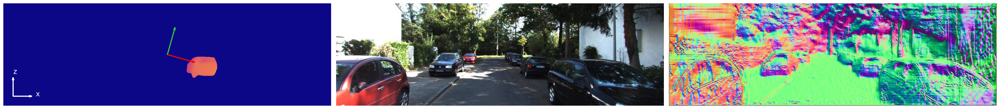

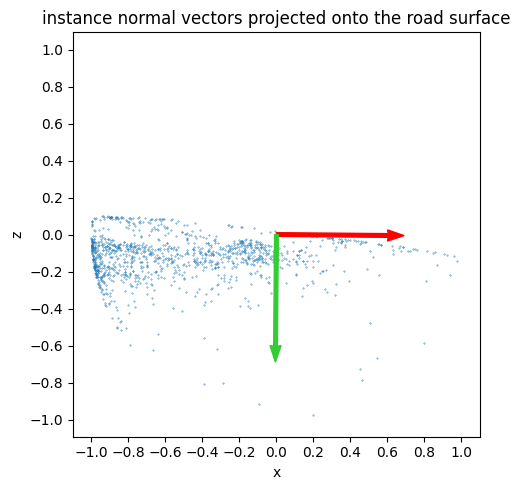

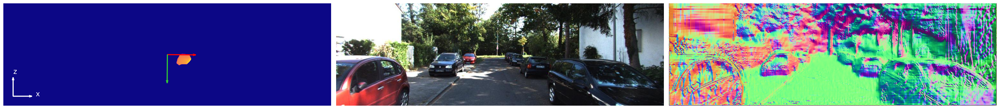

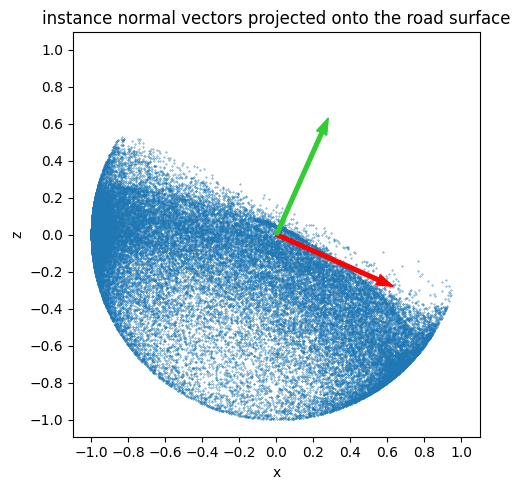

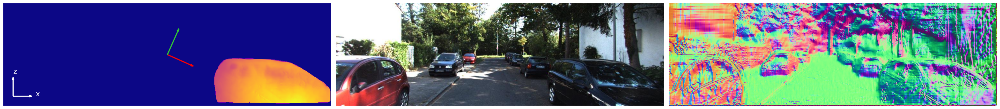

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000521.npz


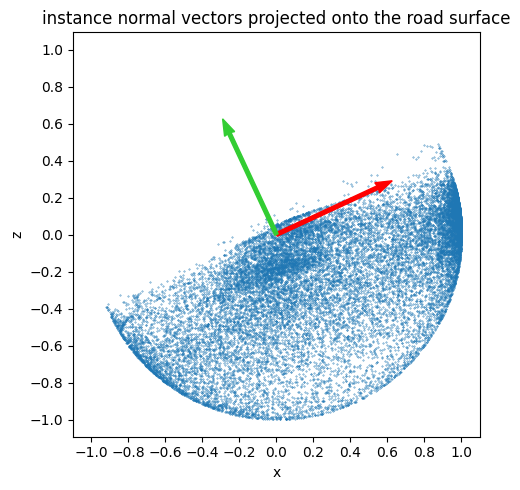

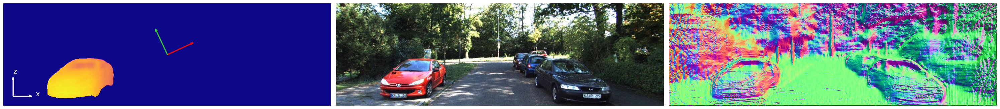

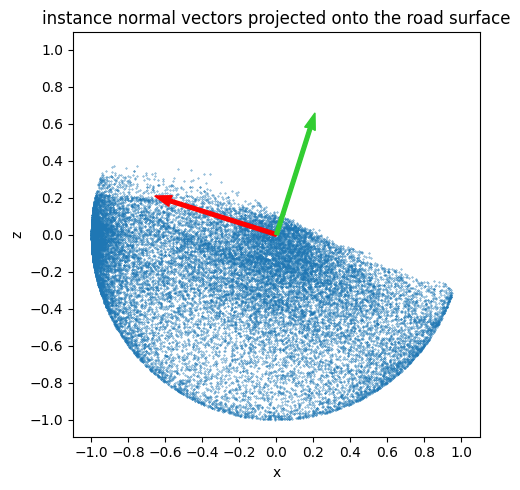

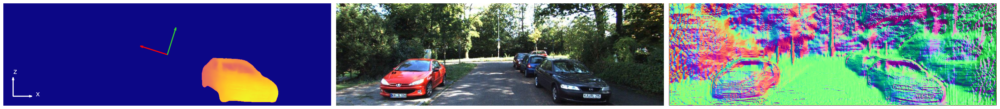

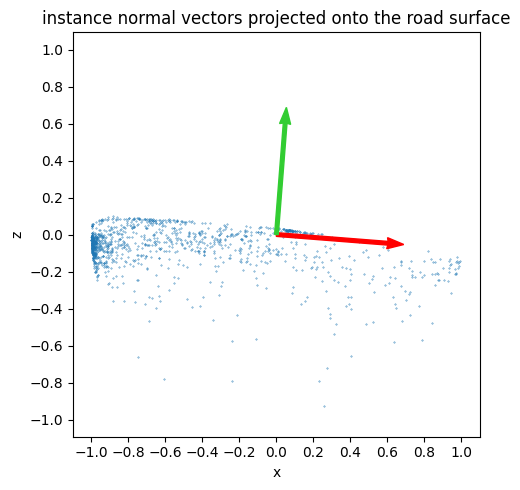

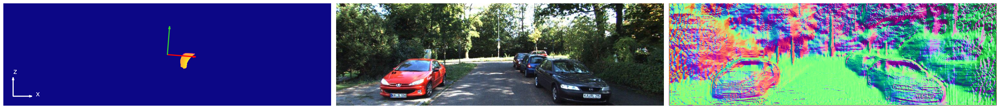

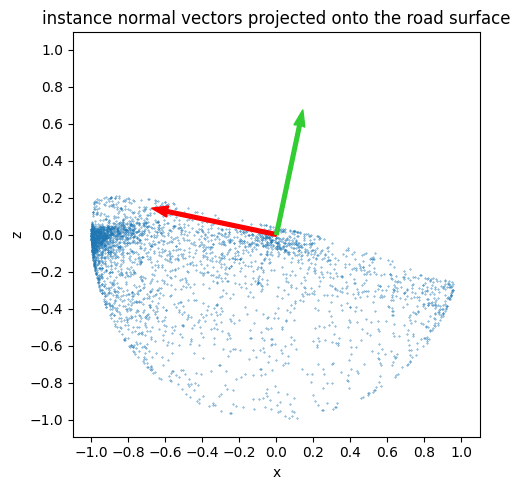

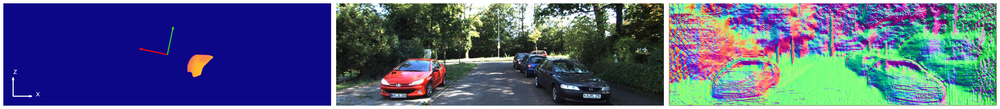

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000541.npz


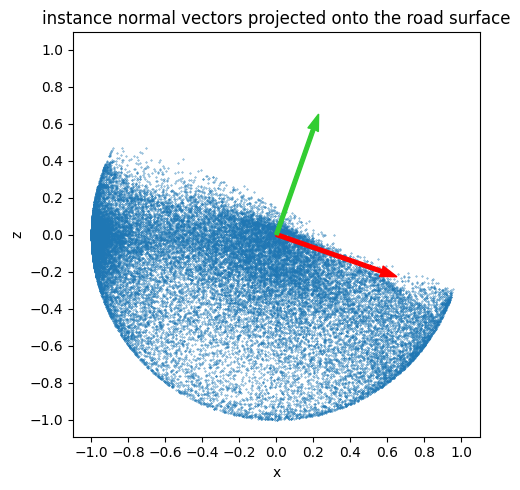

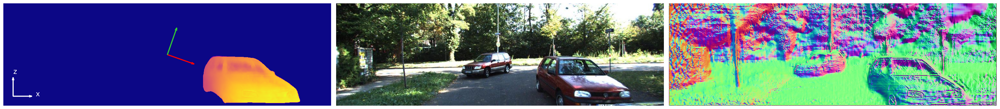

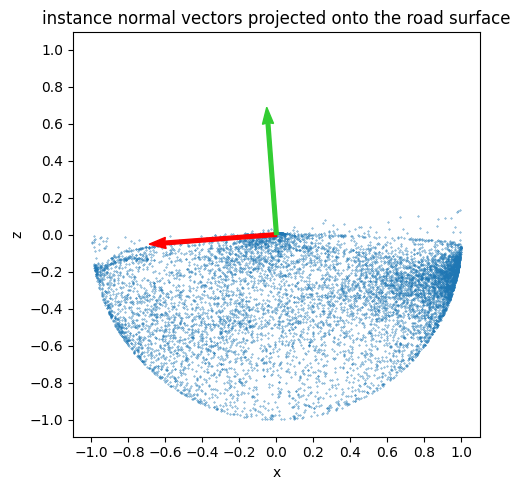

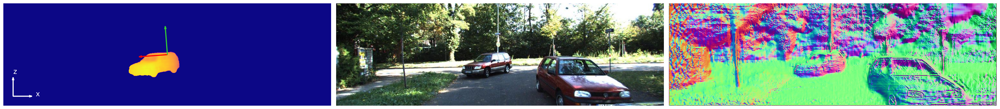

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000561.npz


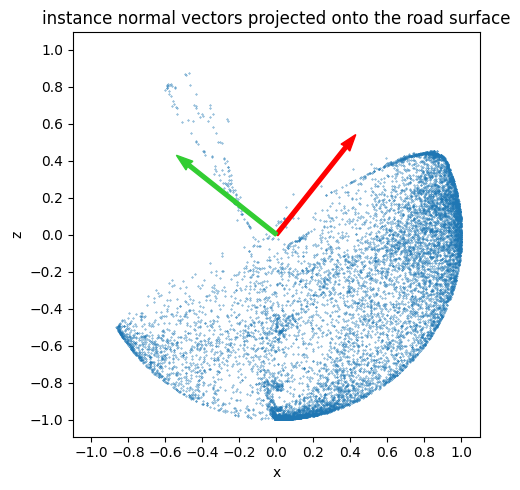

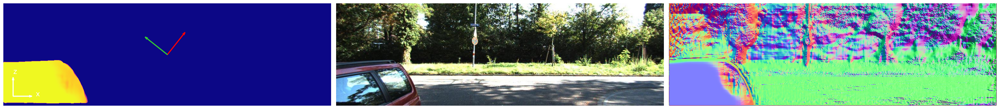

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000581.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000601.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000621.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000641.npz


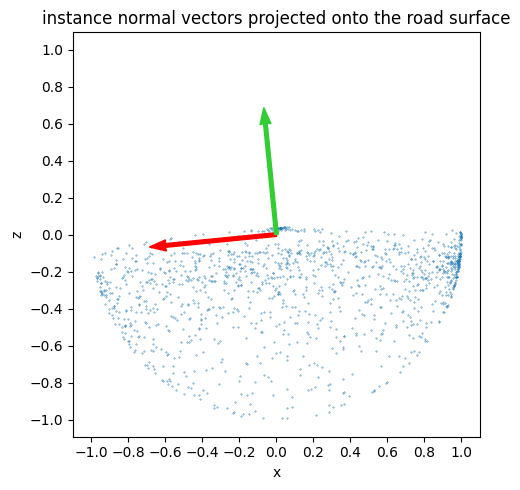

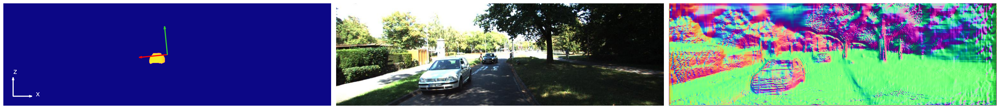

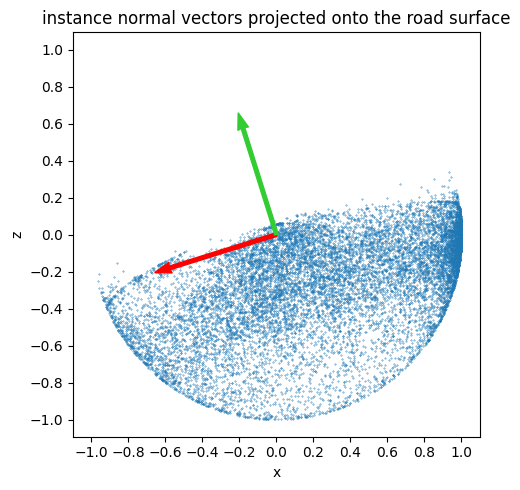

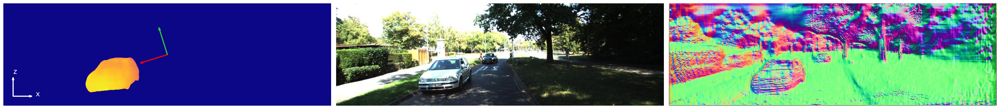

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000661.npz


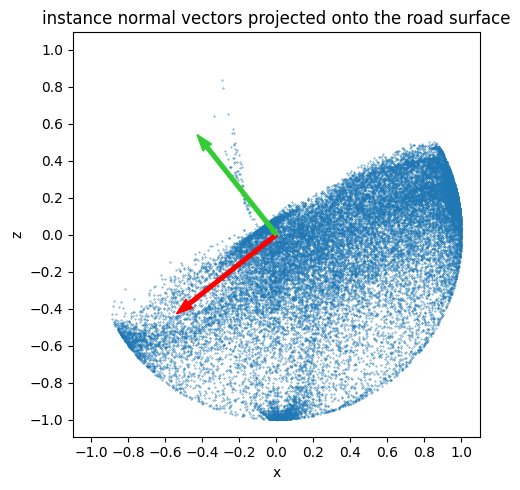

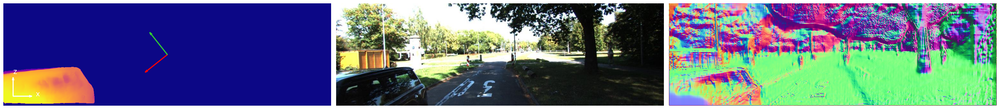

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000681.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000701.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000721.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000741.npz


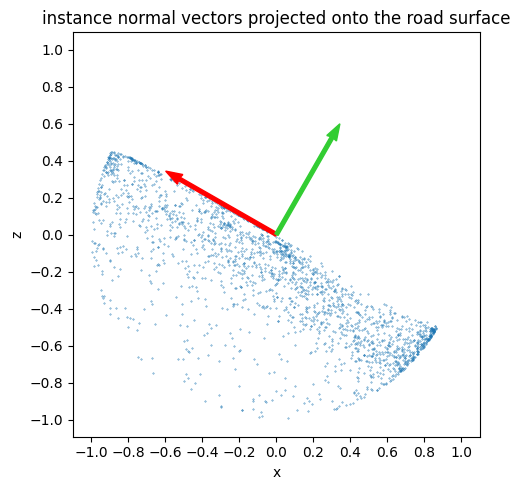

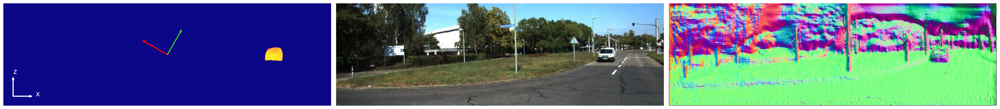

/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000761.npz
/home/gkinoshita/workspace/monodepth2/kitti_data/2011_09_26/2011_09_26_drive_0022_sync/modified_segms_labels_person_car_road_1024x320_02/0000000781.npz


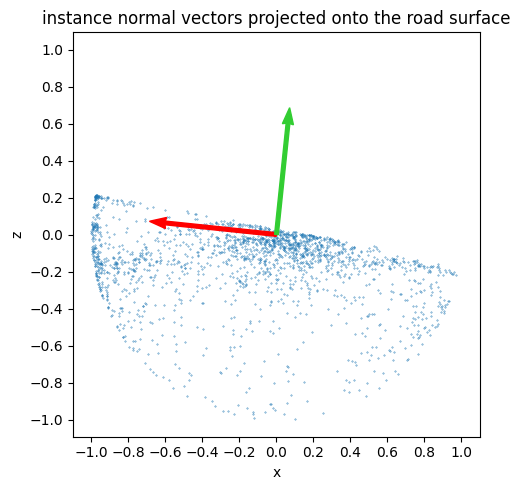

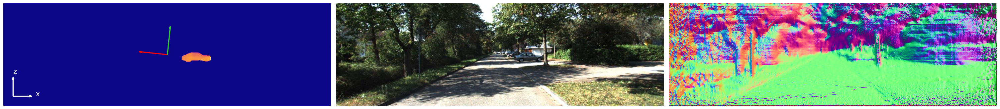

IndexError: list index out of range

In [5]:
pos_offset = 30
offset = 80
arrow_len = 50
rgb = ("red", "limegreen", "dodgerblue")

segm_paths = sorted(segm_dir.iterdir())[1:]
start = 500
for idx in range(start, 500 + start, 20):
    segm_path = segm_paths[idx]
    segms_labels_road = np.load(segm_path)
    segms = torch.tensor(segms_labels_road["segms"]).to(bool)
    labels = torch.tensor(segms_labels_road["labels"]).to(torch.uint8)
    road = segms[0]
    segms = segms[1:]
    img = torch.tensor(np.array(Image.open(img_dir / f"{segm_path.stem}.jpg"), dtype=np.uint8))
    if is_manydepth:
        disp = torch.tensor(np.load(disp_dir / f"{segm_path.stem}.npy")).squeeze().to(torch.float32)
    else:
        disp = torch.tensor(np.load(disp_dir / f"{segm_path.stem}_disp.npy")).squeeze().to(torch.float32)
    #################################################################
    print(segm_path)
    _, depth = disp_to_depth(disp)
    cam_grid = generate_cam_grid(h, w, invK)
    batch_cam_pts = depths2cam_pts(depth.unsqueeze(0), cam_grid)
    batch_cam_height, batch_normal = cam_pts2cam_height_with_cross_prod(batch_cam_pts)
    normal = batch_normal.squeeze(0)
    cam_height = batch_cam_height.squeeze(0)[road].mean()
    road_normal = normal[road].mean(0)
    road_normal /= torch.norm(road_normal)
    for segm in segms:
        if segm.sum() < 1000:
            continue
        projected_normal_vecs = normal[segm] - road_normal * (normal[segm] @ road_normal).unsqueeze(-1)
        # mask = projected_normal_vecs[:, 0] ** 2 + projected_normal_vecs[:, 2] ** 2 > 0.5
        # projected_normal_vecs = projected_normal_vecs[mask]
        U, S, V = torch.pca_lowrank(projected_normal_vecs)
        xs, ys = convert_coords_projected_normal_vecs(road_normal, projected_normal_vecs)
        # plt.figure(figsize=(5, 5))
        # plt.axis('equal')
        # # plt.scatter(xs, ys, s=0.1)
        # # sns.kdeplot(x=xs, y=ys, fill=True, thresh=0, cmap="mako")
        # plt.hist2d(xs.numpy(), ys.numpy(), bins=(50, 50), cmap=plt.cm.jet, cmin=0)
        # for i in range(2):
        #     plt.arrow(0, 0, V[:, i][0] * 0.6, V[:, i][2] * 0.6, color=rgb[i], width=0.02, overhang=0.05) # [x, z] (原点が左上なので，z>0の方向を上にするならV[:, i][2]の正負を逆にしないとダメ)
        # plt.xlim(-1.1, 1.1)
        # plt.ylim(-1.1, 1.1)
        # plt.xticks(torch.arange(-1, 1 + 0.2, 0.2))
        # plt.yticks(torch.arange(-1, 1 + 0.2, 0.2))
        # plt.title("instance normal vectors projected onto the road surface")
        # plt.xlabel("x")
        # plt.ylabel("z")
        fig, ax = plt.subplots(figsize=(5, 5))
        ax.axis('equal')
        plt.scatter(xs, ys, s=0.1)
        # ax.hist2d(xs.numpy(), ys.numpy(), bins=(50, 50), cmap=plt.cm.jet, cmin=1)
        for i in range(2):
            ax.arrow(0, 0, V[:, i][0] * 0.6, V[:, i][2] * 0.6, color=rgb[i], width=0.02, overhang=0.05) # [x, z] (原点が左上なので，z>0の方向を上にするならV[:, i][2]の正負を逆にしないとダメ)
        ax.set_xlim(-1.1, 1.1)
        ax.set_ylim(-1.1, 1.1)
        ax.set_xticks(torch.arange(-1, 1 + 0.2, 0.2))
        ax.set_yticks(torch.arange(-1, 1 + 0.2, 0.2))
        ax.set_title("instance normal vectors projected onto the road surface")
        ax.set_xlabel("x")
        ax.set_ylabel("z")
        plt.tight_layout()
        plt.show()
        plt.close()
        n_fig = 3
        fig, axes = plt.subplots(1, n_fig, figsize=(n_fig * 10, 5))
        plt_idx = 0
        axes[plt_idx].imshow(disp * segm, cmap="plasma")
        # print(f"{S=}")
        for i in range(2):
            # print(V[:, i])
            # plt.arrow(w // 2, h // 2, V[:, i][0] * offset, V[:, i][1] * offset, color=rgb[i]) # [x, y]
            axes[plt_idx].arrow(w // 2, h // 2, V[:, i][0] * offset, -V[:, i][2] * offset, color=rgb[i], width=2, overhang=1) # [x, z] (原点が左上なので，z>0の方向を上にするならV[:, i][2]の正負を逆にしないとダメ)
        axes[plt_idx].arrow(pos_offset, h - pos_offset, arrow_len, 0, color="w", width=2, overhang=1)
        axes[plt_idx].arrow(pos_offset, h - pos_offset, 0, -arrow_len, color="w", width=2, overhang=1)
        axes[plt_idx].text(pos_offset + arrow_len + 20, h - pos_offset, "x", color="w", fontsize=15)
        axes[plt_idx].text(pos_offset, h - pos_offset - arrow_len - 20, "z", color="w", fontsize=15)
        plt.tight_layout()
        axes[plt_idx].axis('off')
        plt_idx += 1
        axes[plt_idx].imshow(img)
        axes[plt_idx].axis('off')
        plt.tight_layout()
        plt_idx += 1
        axes[plt_idx].imshow((normal * np.array((1, -1, -1)) + 1) / 2)
        axes[plt_idx].axis('off')
        plt.tight_layout()
        plt.show()
        plt.close()

    # plt.figure(figsize=(30, 5))
    # plt.subplot(1, 3, 1)
    # plt.imshow(segms.sum(axis=0))
    # plt.axis('off')
    # plt.subplot(1, 3, 2)
    # plt.imshow(img)
    # plt.axis('off')
    # plt.subplot(1, 3, 3)
    # plt.imshow(disp, cmap="Spectral")
    # plt.tight_layout()
    # plt.axis('off')
    # plt.show()
    # plt.close()
    # break

In [6]:
xs.shape

torch.Size([18884])

In [45]:
_, depth = disp_to_depth(disp)
cam_grid = generate_cam_grid(h, w, invK)
batch_cam_pts = depths2cam_pts(depth.unsqueeze(0), cam_grid)
_, batch_normal = cam_pts2cam_height_with_cross_prod(batch_cam_pts)
normal = batch_normal.squeeze(0)
road_normal = normal[road].mean(0)
road_normal /= torch.norm(road_normal)
projected_normal_vecs = normal[segms[0]] - road_normal * (normal[segms[0]] @ road_normal).unsqueeze(-1)
U, S, V = torch.pca_lowrank(projected_normal_vecs)
# # U, S, V = torch.pca_lowrank(normal[segms[0]])

tensor([-0.9646,  0.0301, -0.2621])
tensor([-0.2629, -0.0263,  0.9645])
tensor([0.0221, 0.9992, 0.0333])


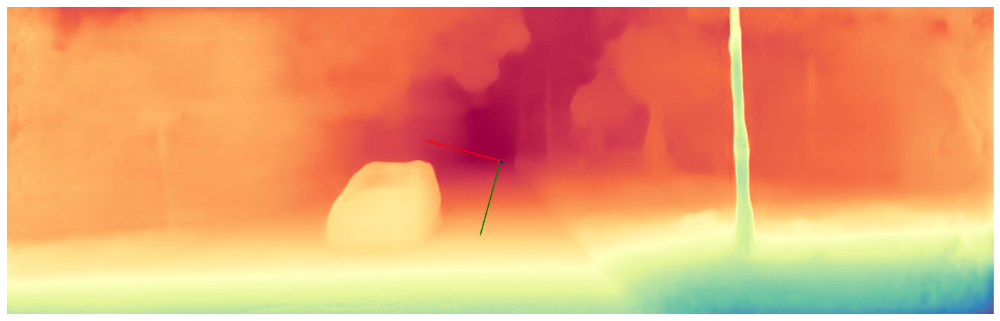

In [46]:
offset = 80
plt.figure(figsize=(20, 5))
plt.imshow(disp, cmap="Spectral")
rgb = "rgb"
for i in range(V.shape[1]):
    print(V[:, i])
    # plt.arrow(w // 2, h // 2, V[:, i][0] * offset, V[:, i][1] * offset, color=rgb[i])
    plt.arrow(w // 2, h // 2, V[:, i][0] * offset, V[:, i][2] * offset, color=rgb[i]) # [x, z]
plt.tight_layout()
plt.axis('off')
plt.show()
plt.close()

In [38]:
road_normal

tensor([-0.0145, -0.9995, -0.0265])

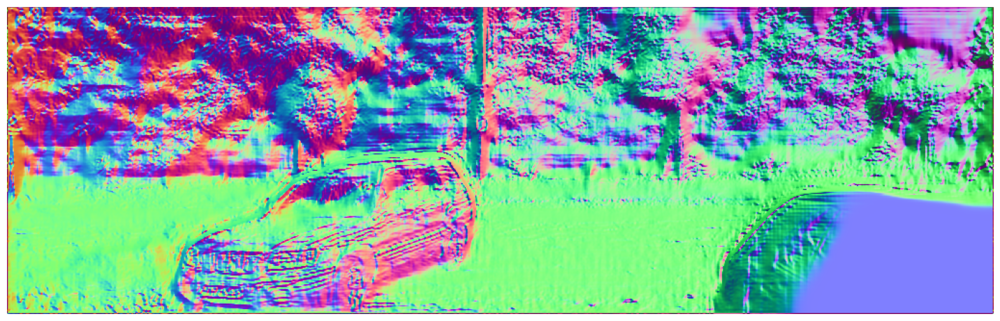

In [160]:
plt.figure(figsize=(20, 5))
plt.imshow((normal * np.array((1, -1, -1)) + 1) / 2)
plt.tight_layout()
plt.axis('off')
plt.show()
plt.close()